# Analysis on METs score

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.subplots as sp
import plotly.tools as tls
import os

sns.set(style="whitegrid", font_scale=3)
pd.set_option('display.max_columns', None)

In [2]:
# Enumeration of all the files in the dataset folder
ds = sorted(os.listdir('dataset'))
print(f"Element present in the dataset: {len(ds)}")
dataset = {}
for file in ds:
    #print(file)
    dataset[file.split('_')[0]] = pd.read_csv(f"dataset/{file}")

Element present in the dataset: 18


In [3]:
df_met = dataset['minuteMETsNarrow'].copy(deep=True)

In [4]:
df_met['METs'] /= 10

In [5]:
df_met.describe()

,Id,METs
count,1.325580e+06,1.325580e+06
mean,4.847898e+09,1.469001e+00
std,2.422313e+09,1.205541e+00
min,1.503960e+09,0.000000e+00
25%,2.320127e+09,1.000000e+00
50%,4.445115e+09,1.000000e+00
75%,6.962181e+09,1.100000e+00
max,8.877689e+09,1.570000e+01


In [6]:
def get_METs_category(met_val):
    cat = 'Sedentary'
    if met_val >= 1.5 and met_val < 3:
        cat = 'Light'
    elif met_val >= 3 and met_val < 6:
        cat = 'Moderate'
    elif met_val >= 6:
        cat = 'VeryActive'
    return cat

In [7]:
df_met.head(1)

,Id,ActivityMinute,METs
0,1503960366,4/12/2016 12:00:00 AM,1.0


In [8]:
df_met['ActivityMinute'] = pd.to_datetime(df_met['ActivityMinute'], format='%m/%d/%Y %I:%M:%S %p') 

In [9]:
df_met['Date'] = df_met['ActivityMinute'].dt.date
df_met['Time'] = df_met['ActivityMinute'].dt.time


In [10]:
df_met['Date'] = df_met['Date'].astype('datetime64[ns]')


In [11]:
df_met.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1325580 entries, 0 to 1325579
Data columns (total 5 columns):
 #   Column          Non-Null Count    Dtype         
---  ------          --------------    -----         
 0   Id              1325580 non-null  int64         
 1   ActivityMinute  1325580 non-null  datetime64[ns]
 2   METs            1325580 non-null  float64       
 3   Date            1325580 non-null  datetime64[ns]
 4   Time            1325580 non-null  object        
dtypes: datetime64[ns](2), float64(1), int64(1), object(1)
memory usage: 50.6+ MB


In [12]:
df_met.head()

,Id,ActivityMinute,METs,Date,Time
0,1503960366,2016-04-12 00:00:00,1.0,2016-04-12,00:00:00
1,1503960366,2016-04-12 00:01:00,1.0,2016-04-12,00:01:00
2,1503960366,2016-04-12 00:02:00,1.0,2016-04-12,00:02:00
3,1503960366,2016-04-12 00:03:00,1.0,2016-04-12,00:03:00
4,1503960366,2016-04-12 00:04:00,1.0,2016-04-12,00:04:00


In [13]:
def plot_and_save_group_obs(df, title, figname):
    met_grouped = df.groupby(['Id', 'Time'])[['Date', 'METs']]

    met_grouped = met_grouped.agg({'METs': 'mean'}).reset_index()
    met_grouped = met_grouped.groupby('Id')

    rows = 6
    cols = 2
    fig, ax = plt.subplots(figsize=(40, 80), nrows=rows, ncols=cols)
    for i, element in enumerate(met_grouped):
        index0 = i//rows
        index1 = i%cols
    
        ax[index0, index1].axhline(y=1.5, color='#800080', linestyle='-', linewidth=4, label='Light')
        ax[index0, index1].text(0.5, 1.7, 'Light', fontsize=30, va='center', ha='center', color='#800080')
        ax[index0, index1].axhline(y=3, color='#51414F', linestyle='-', linewidth=4, label='Fairly')
        ax[index0, index1].text(0.5, 3.2, 'Moderate', fontsize=30, va='center', ha='center', color='#51414F')
        ax[index0, index1].axhline(y=6, color='#D8BFD8', linestyle='-', linewidth=4, label='Very active')
        ax[index0, index1].text(0.5, 5.8, 'Very active', fontsize=30, va='center', color='#D8BFD8') 
        element[1].plot(x='Time', y='METs', ax=ax[index0, index1], label=f"{element[0]}")
    fig.suptitle(title, fontsize=40, y=1)
    plt.tight_layout()
    plt.legend()
    plt.show()
    fig.savefig(f'figures/{figname}', dpi=300)

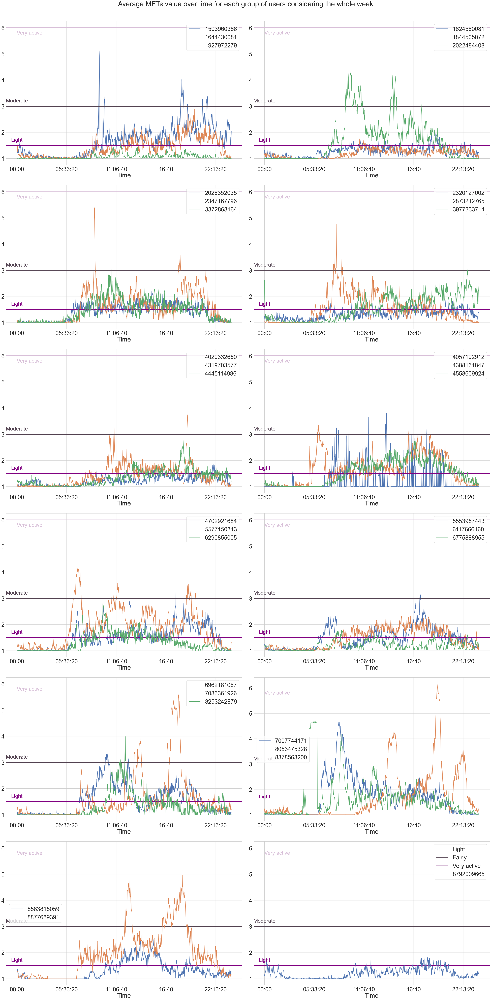

In [14]:
plot_and_save_group_obs(df_met, \
                        'Average METs value over time for each group of users considering the whole week', \
                        'average_METs_value_over_time_for_each_group_of_users.png')

(1325580, 6)


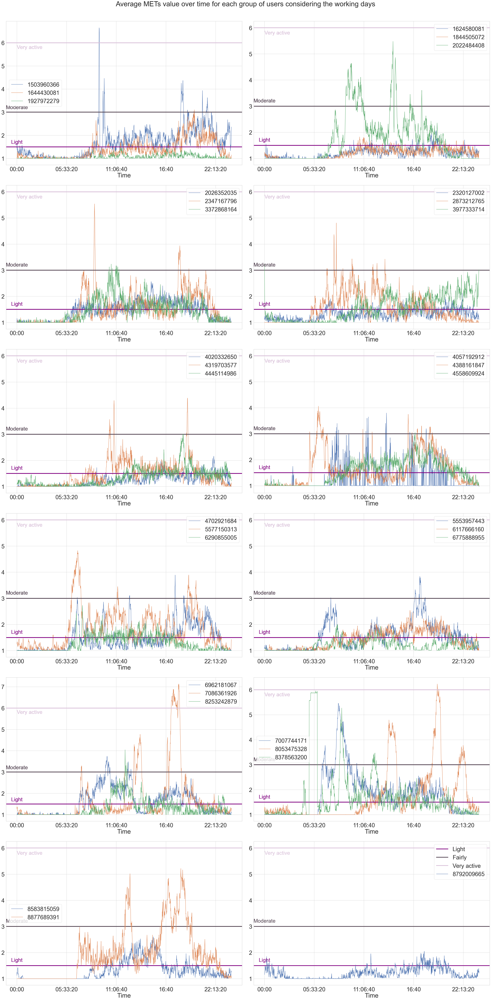

In [15]:
df_met['Weekday'] = df_met['Date'].dt.day_name()
print(df_met.shape)
df = df_met[~df_met['Weekday'].isin(['Saturday', 'Sunday'])]
plot_and_save_group_obs(df, \
                        'Average METs value over time for each group of users considering the working days', \
                        'average_METs_value_over_time_for_each_group_of_users_working_days.png')


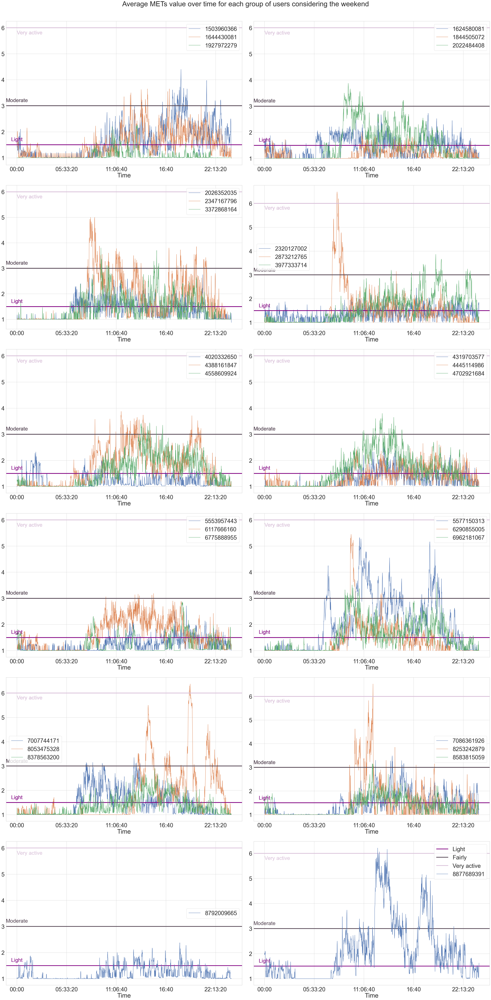

In [16]:
plot_and_save_group_obs(df_met[df_met['Weekday'].isin(['Saturday', 'Sunday'])], \
                        'Average METs value over time for each group of users considering the weekend', \
                        'average_METs_value_over_time_for_each_group_of_users_weekend.png')

In [17]:
df_met['Week'] = df_met['ActivityMinute'].dt.isocalendar().week
df_met_weekly = df_met.groupby(['Id', 'Week'])[['METs', 'Time']]

temp_df = pd.DataFrame(columns=['Id', 'Week', 'Time', 'AvgMETs'])
print(type(temp_df))
for idx, el in df_met_weekly:
    grouped = el.groupby('Time')
    grouped = grouped.aggregate({'METs': 'mean'}).reset_index()
    grouped['Id'] = idx[0]
    grouped['Week'] = idx[1]
    grouped.rename(columns={'METs': 'AvgMETs'}, inplace=True)
    grouped = grouped[['Id', 'Week', 'Time', 'AvgMETs']]
    temp_df = pd.concat([temp_df, grouped], ignore_index=True)


weeks_count = len(temp_df['Week'].unique())
rows = 11
cols = 3
fig, ax = plt.subplots(figsize=(80, 160), nrows=rows, ncols=cols)
fig.suptitle('Average weekly METs values for each user', fontsize=60, y=1)
prev_id = None
i = -1
week = 0
j = - 1
for c, element in enumerate(temp_df.groupby(['Id', 'Week'])):
    if element[0][0] != prev_id :
        prev_id = element[0][0]
        i += 1
    index0 = i//cols
    index1 = i%cols  
    ax[index0, index1].axhline(y=1.5, color='#800080', linestyle='-', linewidth=4)
    ax[index0, index1].text(0.5, 1.7, 'Light', fontsize=30, va='center', ha='center', color='#800080')
    ax[index0, index1].axhline(y=3, color='#51414F', linestyle='-', linewidth=4)
    ax[index0, index1].text(0.5, 3.2, 'Moderately', fontsize=30, va='center', ha='center', color='#51414F')
    ax[index0, index1].axhline(y=6, color='#D8BFD8', linestyle='-', linewidth=4)
    ax[index0, index1].text(0.5, 5.8, 'Very active', fontsize=30, va='center', color='#D8BFD8') 
    element[1].plot(x='Time', y='AvgMETs', ax=ax[index0, index1], label=f"ID: {element[0][0]}, Week: {element[0][1]}")

plt.tight_layout()
plt.legend()

<class 'pandas.core.frame.DataFrame'>


/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_92288/4129728698.py:13: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  temp_df = pd.concat([temp_df, grouped], ignore_index=True)


In [18]:
fig.savefig('figures/Weekly_METs_per_user.png')

## Let's analyse user 8378563200

In [25]:
user_id = 8378563200 
df_met_users = df_met[df_met['Id'] == user_id].copy(deep=True)
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df_met_users['Weekday'] = df_met_users['ActivityMinute'].dt.day_name()
df_met_users['Weekday'] = pd.Categorical(df_met_users['Weekday'], categories=ordered_days, ordered=True)

df_met_user_grouped = df_met_users.groupby(['Time', 'Weekday']).agg({'METs': 'mean'}).reset_index()
fig = sp.make_subplots(rows=4, cols=2, subplot_titles=ordered_days, horizontal_spacing=0.08, vertical_spacing=0.1)
fig.update_layout(title_text=f"Average METs for Each Day for user {user_id}", title_x=0.5, title_y=0.99, title_font=dict(size=40))
subplot_titles = []
for i, e in enumerate(df_met_user_grouped.groupby('Weekday')):
    line = px.line(e[1], x='Time', y='METs', title=f"Average METs on {e[0]} for user: {user_id}")
    line.update_layout(title_font=dict(size=30))
    fig.add_trace(line.data[0], row=(i//2) + 1, col=(i%2) + 1 ) 
    fig.add_hline(y=1.5, line_dash="dash", annotation_text="Light", annotation_position="top left")
    fig.add_hline(y=3, line_dash="dash", annotation_text="Moderate", annotation_position="top left")
    fig.add_hline(y=6, line_dash="dash", annotation_text="Very active", annotation_position="top left")
    fig.update_annotations(font_size=30)
    fig.update_xaxes(title_text="Time", row=i//2 +1, col=i%2+1, tickfont=dict(size=30), title_font=dict(size=25))
    fig.update_yaxes(title_text="METs", row=i//2 +1, col=i%2+1, tickfont=dict(size=30), title_font=dict(size=25))
    subplot_titles.append(f"Average METs on {e[0]}")


fig.update_layout(height=3000, width=3000)
fig.show()
# fig.write_image(f'figures/average_METs_on_each_day_for_user_{user_id}.png')

/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_92288/1496571492.py:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/var/folders/97/yjfp60y90vvgjz812_bx179m0000gn/T/ipykernel_92288/1496571492.py:11: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

